# Exponentially weighted averages

I want to show you a few optimization algorithms. They are faster than gradient descent. In order to understand those algorithms, you need to be able they use something called exponentially weighted averages. Also called exponentially weighted moving averages in statistics. 

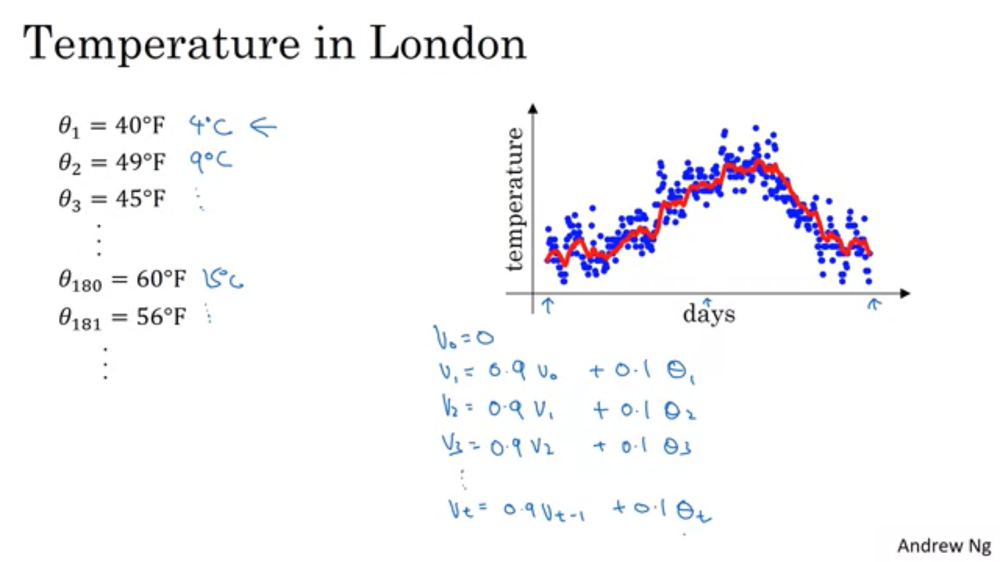

So, if you compute this and plot it in red, this is what you get. You get a `moving average of what's called an exponentially weighted average of the daily temperature.`

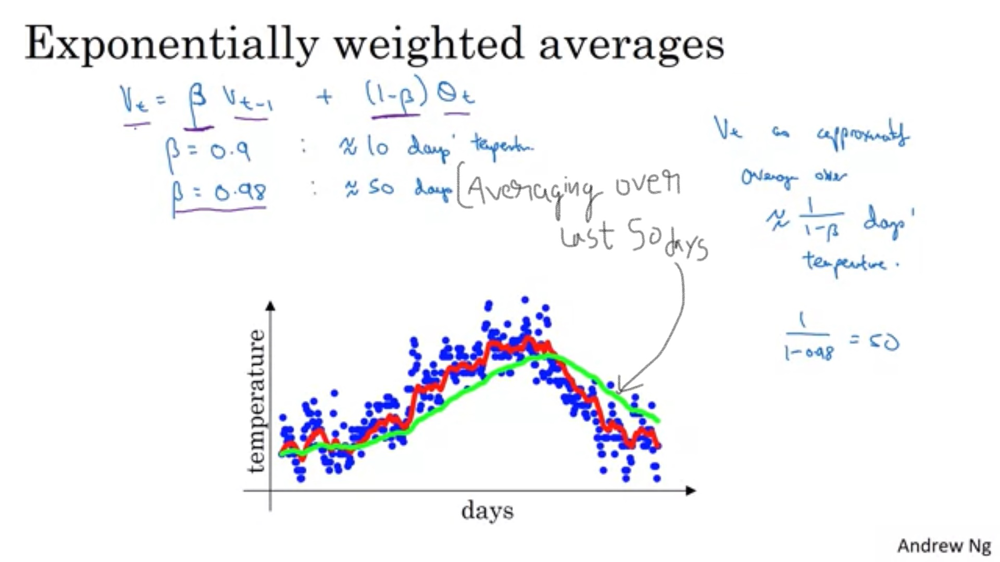

So, notice a couple of things with this very high value of beta. The plot you get is much smoother because you're now averaging over more days of temperature. So, the curve is just, you know, less wavy is now smoother, but on the flip side the curve has now shifted further to the right because you're now averaging over a much larger window of temperatures. And by averaging over a larger window, this formula, this exponentially weighted average formula. It adapts more slowly, when the temperature changes. So, there's just a bit more latency. `And the reason for that is when Beta 0.98 then it's giving a lot of weight to the previous value and a much smaller weight just 0.02, to whatever you're seeing right now.` So, when the temperature changes, when temperature goes up or down, there's exponentially weighted average. Just adapts more slowly when beta is so large.

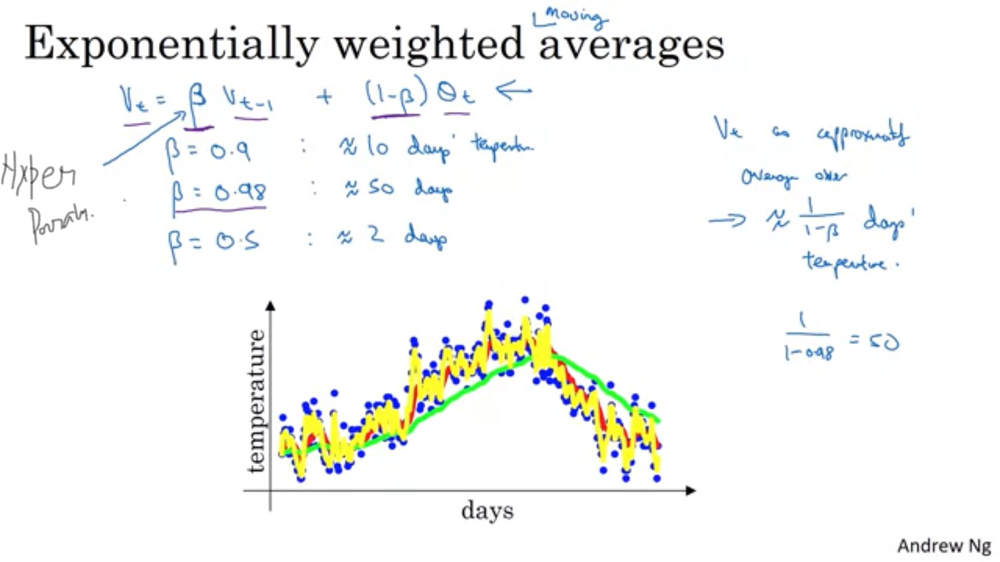

This is something like averaging over just two days temperature, and you plot that you get this yellow line. And by averaging only over two days temperature, you have a much, as if you're averaging over much shorter window. So, you're much more noisy, much more susceptible to outliers. But this adapts much more quickly to what the temperature changes. So, this formula is highly implemented, exponentially weighted average. Again, it's called an exponentially weighted, moving average in the statistics literature.

# Understanding exponentially weighted averages


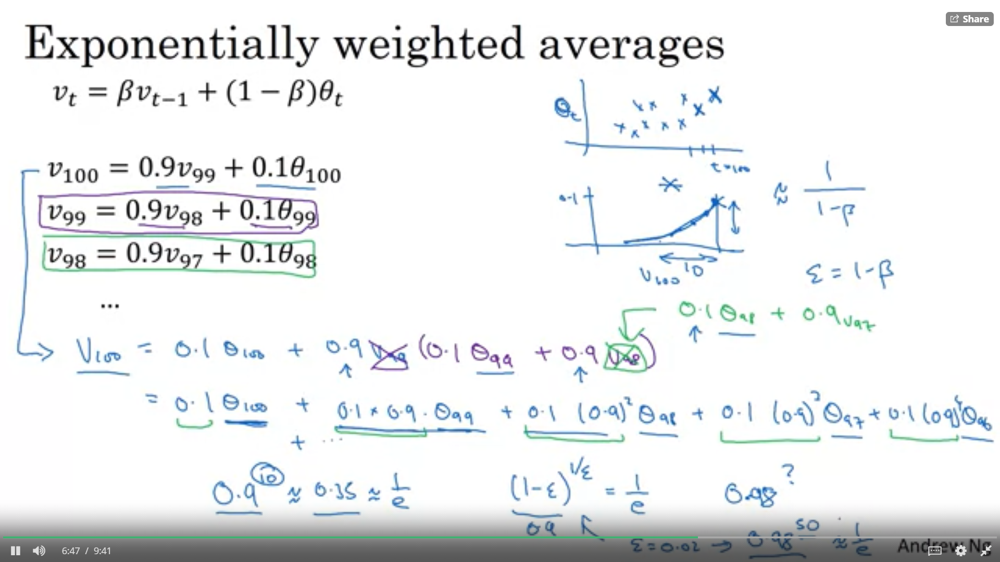

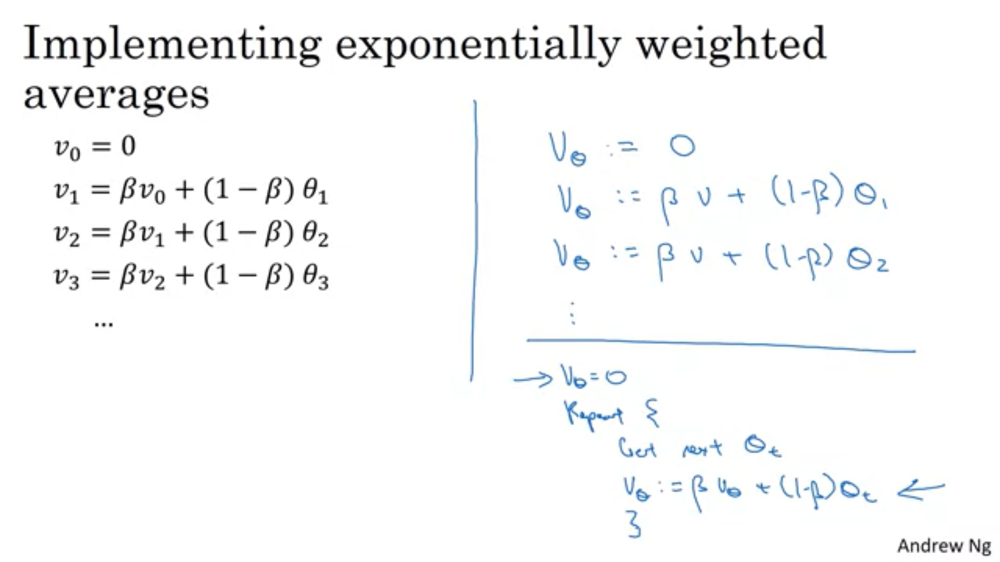

# Bias correction in exponentially weighted averages


here's one technical detail called biased correction that can make you computation of these averages more accurately

But V0 is equal to 0 so that term just goes away. So V1 is just 0.02 times theta 1. So that's why if the first day's temperature is, say 40 degrees Fahrenheit, then v1 will be 0.02 times 40, which is 8. So you get a much lower value down here. So it's not a very good estimate of the first day's temperature. 

So it turns out that there is a way to modify this estimate that makes it much better, that makes it more accurate, especially during this initial phase of your estimate. Which is that, instead of taking Vt, take Vt divided by 1- Beta to the power of t where t is the current data here on. So let's take a concrete example. When t = 2, 1- beta to the power of t is 1- 0.98 squared and it urns out that this is 0.0396. And so your estimate of the tempature on day 2 becomes v2 divided by 0.0396 and this is going to be 0.0196 times theta 1 + 0.02 theta 2. You notice that these two things adds up to the denominator 0.03 and 6. And so this becomes a weighted average of theta 1 and theta 2 and this removes this bias. So you notice that as t becomes large, beta to the t will approach 0 which is why when t is large enough, the bias correction makes almost no difference. This is why when t is large, the purple line and the green line pretty much overlap. But during this initial phase of learning when you're still warming up your estimates when the bias correction can help you to obtain a better estimate of this temperature. And it is this bias correction that helps you go from the purple line to the green line. So in machine learning, for most implementations of the exponential weighted average, people don't often bother to implement bias corrections.

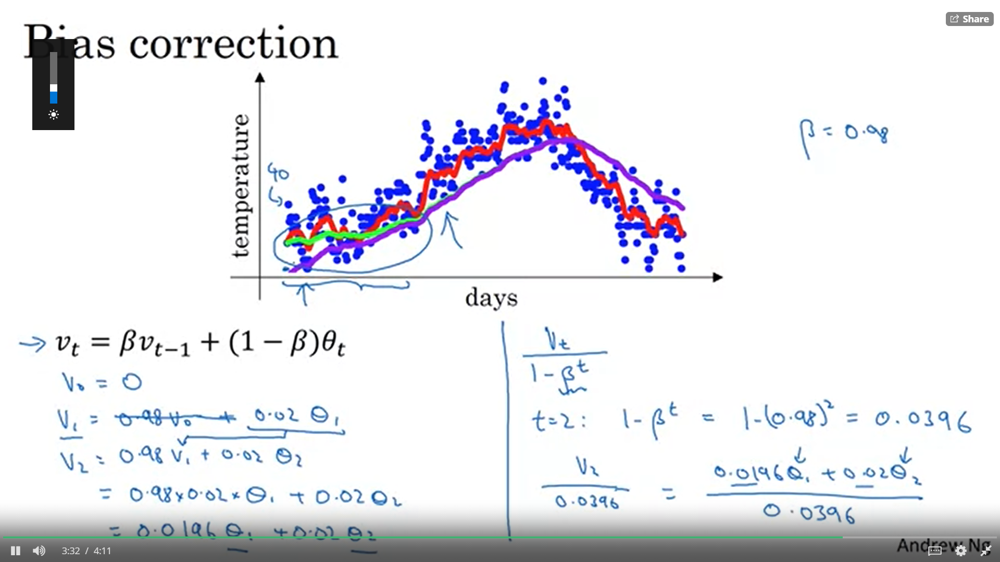

# Gradient descent with momentum


There's an algorithm called momentum, or `gradient descent with momentum that almost always works faster than the standard gradient descent algorithm.` `In one sentence, the basic idea is to compute an exponentially weighted average of your gradients, and then use that gradient to update your weights instead. `

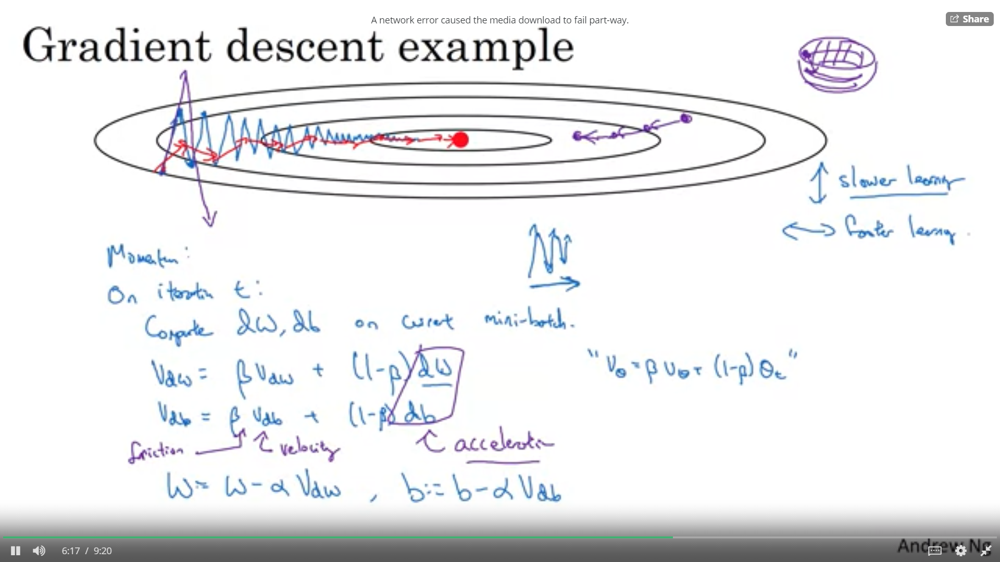

And you see that gradient descents will sort of take a lot of steps, right? Just slowly oscillate toward the minimum. And this up and down oscillations slows down gradient descent and prevents you from using a much larger learning rate. In particular, if you were to use a much larger learning rate you might end up over shooting and end up diverging like so. And so the need to prevent the oscillations from getting too big forces you to use a learning rate that's not itself too large. Another way of viewing this problem is that on the vertical axis you want your learning to be a bit slower, because you don't want those oscillations. But on the horizontal axis, you want faster learning.

Right, so it's computing a moving average of the derivatives for w you're getting.

If you average out these gradients, you find that the oscillations in the vertical direction will tend to average out to something closer to zero. So, in the vertical direction, where you want to slow things down, this will average out positive and negative numbers, so the average will be close to zero. Whereas, on the horizontal direction, all the derivatives are pointing to the right of the horizontal direction, so the average in the horizontal direction will still be pretty big. So that's why with this algorithm, with a few iterations you find that the gradient descent with momentum ends up eventually just taking steps that are much smaller oscillations in the vertical direction, but are more directed to just moving quickly in the horizontal direction. And so this allows your algorithm to take a more straightforward path, or to damp out the oscillations in this path to the minimum.

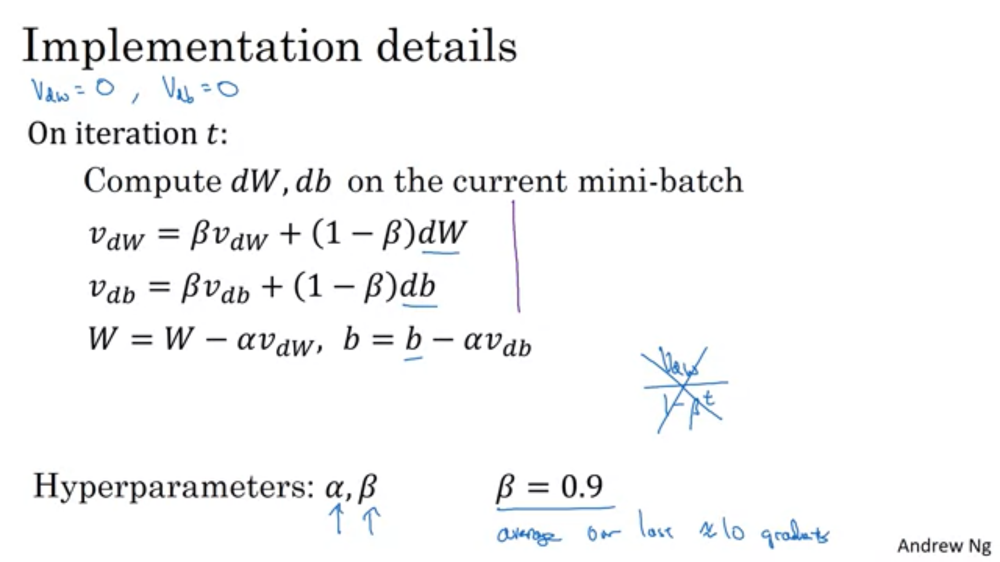

 In practice, people don't usually do this because after just ten iterations, your moving average will have warmed up and is no longer a bias estimate. So in practice, I don't really see people bothering with bias correction when implementing gradient descent or momentum. And of course this process initialize the vdW equals 0. Note that this is a matrix of zeroes with the same dimension as dW, which has the same dimension as W. And Vdb is also initialized to a vector of zeroes. So, the same dimension as db, which in turn has same dimension as b.

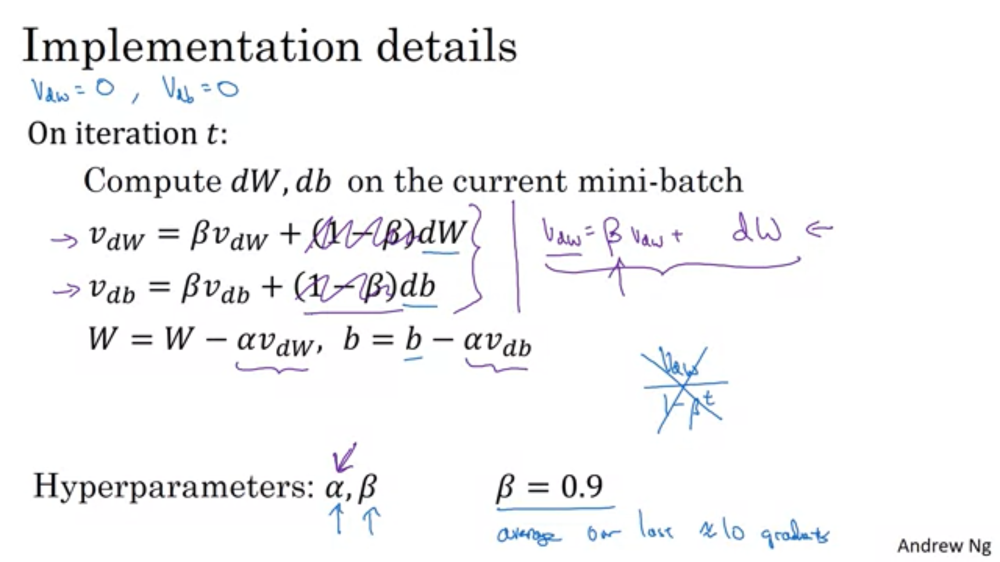

Finally, I just want to mention that if you read the literature on gradient descent with momentum often you see it with this term omitted, with this 1 minus Beta term omitted. So you end up with vdW equals Beta vdw plus dW. And the net effect of using this version in purple is that vdW ends up being scaled by a factor of 1 minus Beta, or really 1 over 1 minus Beta. And so when you're performing these gradient descent updates, alpha just needs to change by a corresponding value of 1 over 1 minus Beta. In practice, both of these will work just fine, it just affects what's the best value of the learning rate alpha. But I find that this particular formulation is a little less intuitive. Because one impact of this is that if you end up tuning the hyperparameter Beta, then this affects the scaling of vdW and vdb as well. And so you end up needing to retune the learning rate, alpha, as well, maybe. So I personally prefer the formulation that I have written here on the left, rather than leaving out the 1 minus Beta term. But, so I tend to use the formula on the left, the printed formula with the 1 minus Beta term. But both versions having Beta equal 0.9 is a common choice of hyper parameter. It's just at alpha the learning rate would need to be tuned differently for these two different versions

# Root Mean Square(RMS) Prop 
   #### This algo also increase up the rate of gradient Descent

 And so, you want to slow down the learning in the b direction, or in the vertical direction. `And speed up learning, or at least not slow it down in the horizontal direction. So this is what the RMSprop algorithm does to accomplish this`. On iteration t, it will compute as usual the derivative dW, db on the current mini-batch. So I was going to keep this exponentially weighted average. Instead of VdW, I'm going to use the new notation SdW. So SdW is equal to beta times their previous value + 1- beta times dW squared. Sometimes [INAUDIBLE] as dW squared. So for clarity, this squaring operation is an element-wise squaring operation. So what this is doing is really keeping an exponentially weighted average of the squares of the derivatives. And similarly, we also have Sdb equals beta Sdb + 1- beta, db squared. And again, the squaring is an element-wise operation. Next, RMSprop then updates the parameters as follows. W gets updated as W minus the learning rate, and whereas previously we had alpha times dW, now it's dW divided by square root of SdW. And b gets updated as b minus the learning rate times, instead of just the gradient, this is also divided by, now divided by Sdb.

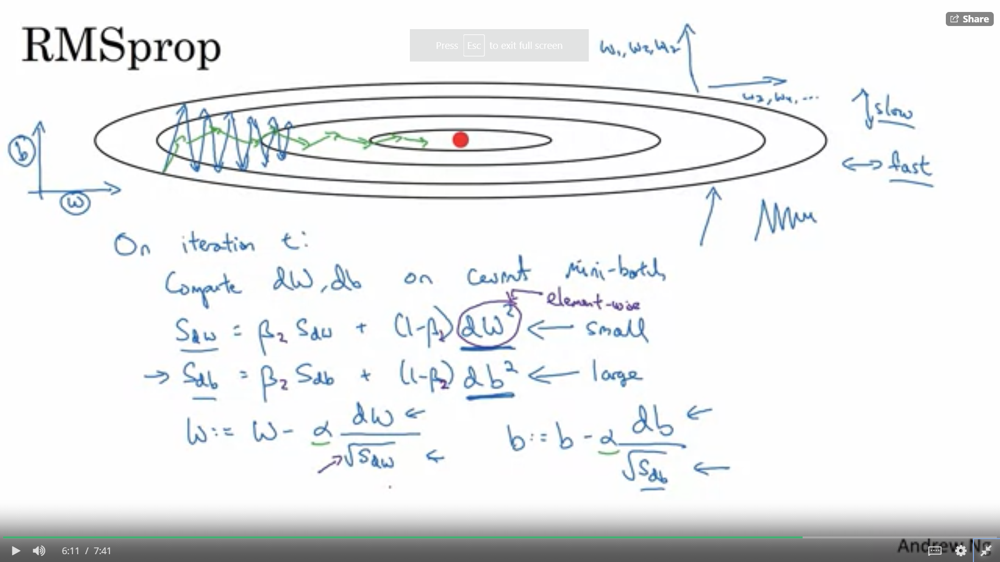

So the net impact of using RMSprop is that your updates will end up looking more like this.
That your updates in the, Vertical direction and then horizontal direction you can keep going. And one effect of this is also that you can therefore use a larger learning rate alpha, and get faster learning without diverging in the vertical direction.

What if square root of SdW, right, is very close to 0. Then things could blow up. Just to ensure numerical stability, when you implement this in practice you add a very, very small epsilon to the denominator. It doesn't really matter what epsilon is used. 10 to the -8 would be a reasonable default, but this just ensures slightly greater numerical stability that for numerical round off or whatever reason, that you don't end up dividing by a very, very small number. So that's RMSprop, and similar to momentum, has the effects of damping out the oscillations in gradient descent, in mini-batch gradient descent. And allowing you to maybe use a larger learning rate alpha. And certainly speeding up the learning speed of your algorithm. 

# Adam optimization algorithm


So, rms prop and the Adam optimization algorithm, which we'll talk about in this video, is one of those rare algorithms that has really stood up, and has been shown to work well across a wide range of deep learning architectures So, this is one of the algorithms that I wouldn't hesitate to recommend you try because many people have tried it and seen it work well on many problems. And the Adam optimization algorithm is basically taking momentum and rms prop and putting them together.

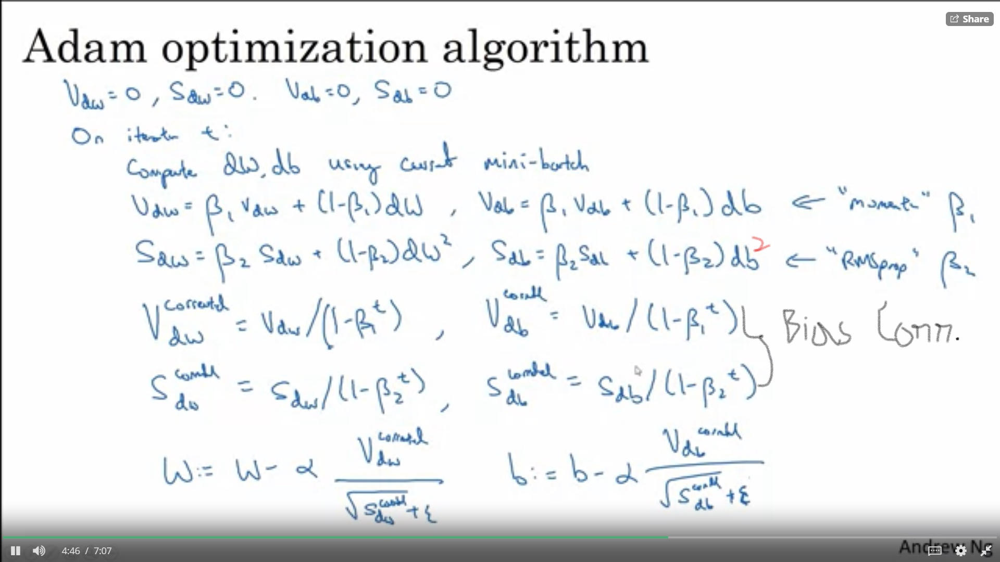

But when implementing Adam, what people usually do is just use the default value. So, ß1 and ß2 as well as epsilon. I don't think anyone ever really tunes Epsilon. And then, try a range of values of Alpha to see what works best. You could also tune ß1 and ß2 but it's not done that often among the practitioners I know.

# Learning rate decay


`One of the things that might help speed up your learning algorithm, is to slowly reduce your learning rate over time. We call this learning rate decay.`

So the intuition behind slowly reducing alpha, is that maybe during the initial steps of learning, you could afford to take much bigger steps. But then as learning approaches converges, then having a slower learning rate allows you to take smaller steps. So here's how you can implement learning rate decay.

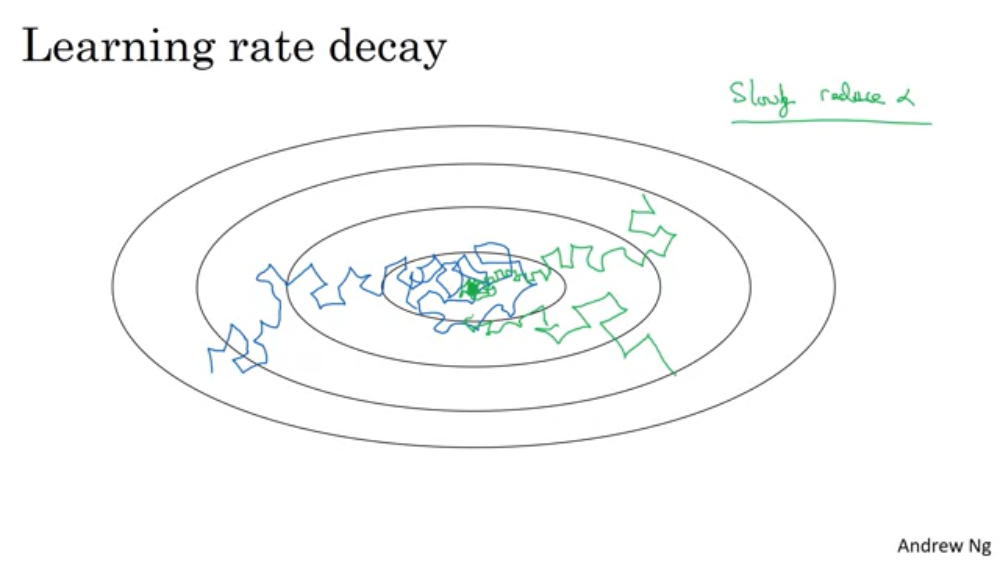

`1 epoch=1 pass through the DATA `

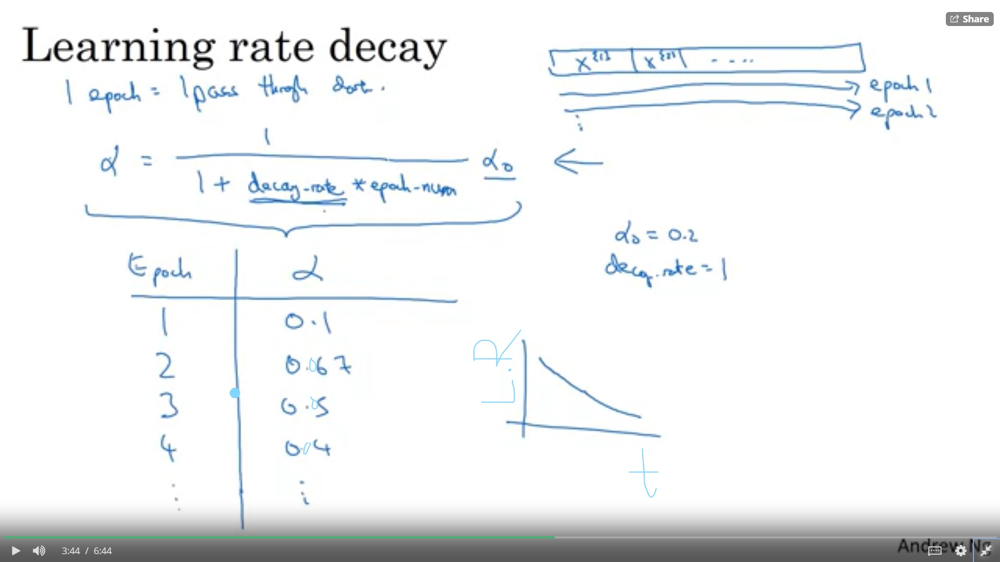

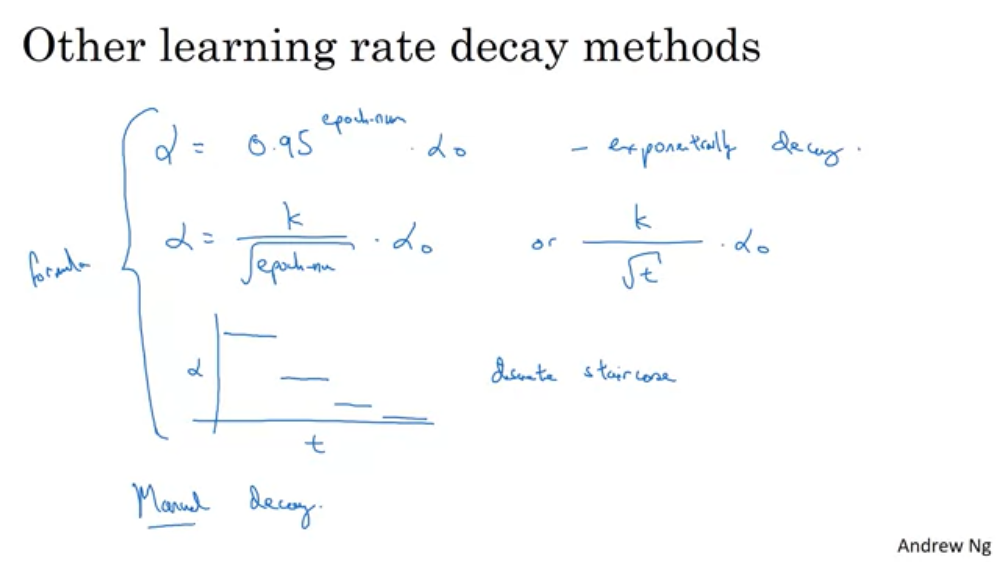

# The problem of local optima


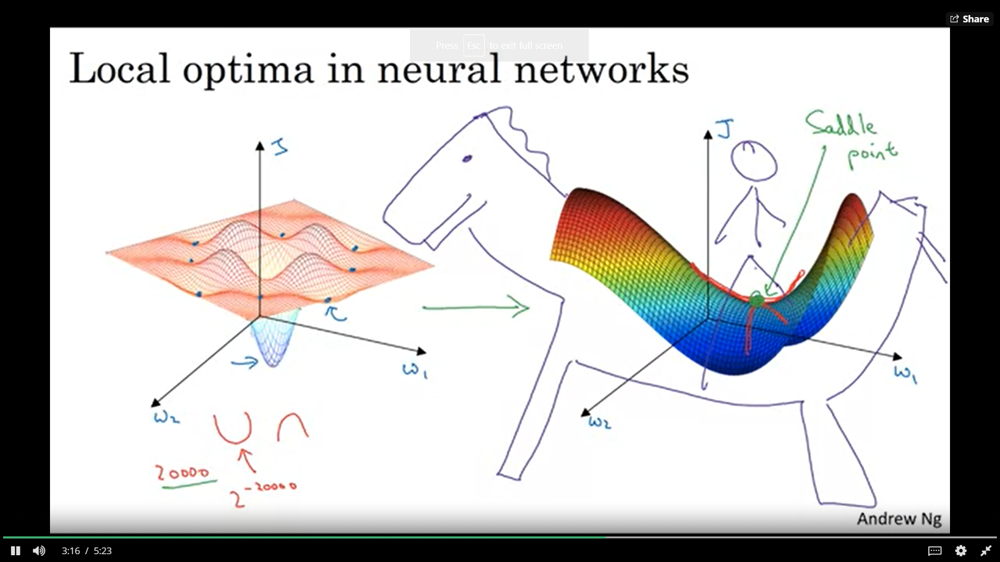

But this intuition isn't actually correct. It turns out if you create a neural network, most points of zero gradients are not local optima like points like this. Instead most points of zero gradient in a cost function are saddle points. So, that's a point where the zero gradient, again, just is maybe W1, W2, and the height is the value of the cost function J. But informally, a function of very high dimensional space, if the gradient is zero, then in each direction it can either be a convex light function or a concave light function. And if you are in, say, a 20,000 dimensional space, then for it to be a local optima, all 20,000 directions need to look like this. And so the chance of that happening is maybe very small, maybe two to the minus 20,000. Instead you're much more likely to get some directions where the curve bends up like so, as well as some directions where the curve function is bending down rather than have them all bend upwards. So that's why in very high-dimensional spaces you're actually much more likely to run into a saddle point like that shown on the right, then the local optimum.

And so, one of the lessons we learned in history of deep learning is that a lot of our intuitions about low-dimensional spaces, like what you can plot on the left, they really don't transfer to the very high-dimensional spaces that any other algorithms are operating over. Because if you have 20,000 parameters, then J as your function over 20,000 dimensional vector, then you're much more likely to see saddle points than local optimum. If local optima aren't a problem, then what is a problem? It turns out that plateaus can really slow down learning and a plateau is a region where the derivative is close to zero for a long time. So if you're here, then gradient descents will move down the surface, and because the gradient is zero or near zero, the surface is quite flat.

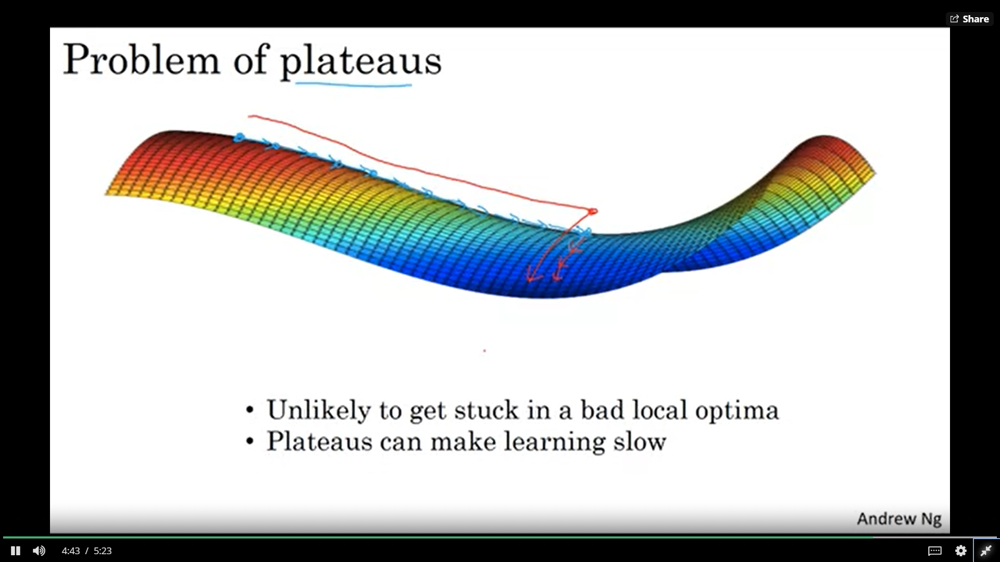